<a href="https://colab.research.google.com/github/samj786/NCVPRIPG-AutoEval/blob/main/MainCode.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Detecting Rotation and rotating

In [ ]:
!pip install pillow

In [ ]:
!pip install pytesseract

In [ ]:
!apt-get install tesseract-ocr

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd
0 upgraded, 3 newly installed, 0 to remove and 45 not upgraded.
Need to get 4,816 kB of archives.
After this operation, 15.6 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-eng all 1:4.00~git30-7274cfa-1.1 [1,591 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-osd all 1:4.00~git30-7274cfa-1.1 [2,990 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr amd64 4.1.1-2.1build1 [236 kB]
Fetched 4,816 kB in 2s (2,088 kB/s)
Selecting previously unselected package tesseract-ocr-eng.
(Reading database ... 121913 files and directories currently installed.)
Preparing to unpack .../tesseract-ocr-

In [ ]:
from PIL import Image
import pytesseract
import cv2 as cv

In [ ]:
# Step 1: Open the original image
path = '/content/20240328_153338.jpg'
original_im = Image.open(path)

# Step 2: Enhance the contrast of the original image for better OCR
im = original_im.convert('L')  # Convert to grayscale
im = im.point(lambda x: 0 if x < 128 else 255, '1')  # Binarize the image

In [ ]:
# Display the processed image
display(im)

In [ ]:
# Step 3: Perform OCR to detect the rotation angle
osd = pytesseract.image_to_osd(im, output_type='dict')
print(osd)

{'page_num': 0, 'orientation': 0, 'rotate': 0, 'orientation_conf': 26.52, 'script': 'Latin', 'script_conf': 8.53}


In [ ]:
# Step 4: Rotate the original image based on the detected angle
rotate = osd['rotate']
if rotate!= 0:
  im_fixed = original_im.rotate(-rotate, expand=True)  # Rotate the original image

else :
  im_fixed = original_im

# Step 5: Save the final image in the directory
output_path = '/content/rotated_image.jpg'
im_fixed.save(output_path)

print(f"Saved the corrected image as {output_path}")

Saved the corrected image as /content/rotated_image.jpg


## Pre-Processing image

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image, ImageDraw
import IPython.display as display

In [ ]:
import matplotlib.patches as patches
from matplotlib.patches import Patch

In [ ]:
import os

In [ ]:
output_path

'/content/rotated_image.jpg'

In [ ]:
#reading the image
image = cv.imread(output_path)

#grayscale
gray_img = cv.cvtColor(image, cv.COLOR_BGR2GRAY)

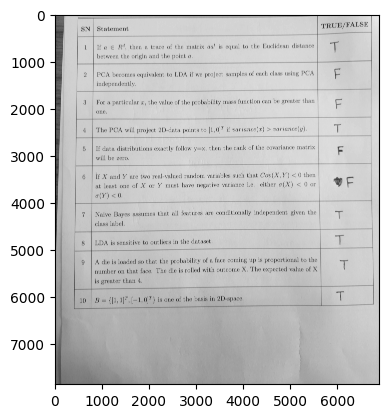

In [ ]:
plt.imshow(gray_img, cmap = "gray")

In [ ]:
#noise removal
median = cv.medianBlur(gray_img, 5)

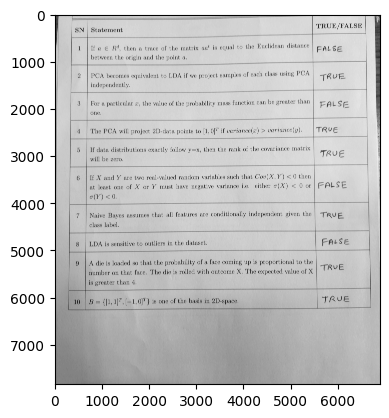

In [ ]:
plt.imshow(median, cmap = "gray")

In [ ]:
#Apply Otsu's thresholding - binarization
#_, binary = cv.threshold(median, 0, 255, cv.THRESH_BINARY + cv.THRESH_OTSU)

In [ ]:
#imgplot = plt.imshow(binary, cmap = "gray")

## TABLE RECOG

In [ ]:
# Convert the image to a PIL image
binary_pil = Image.fromarray(median).convert("RGB")

In [ ]:
from transformers import AutoModelForObjectDetection

model = AutoModelForObjectDetection.from_pretrained("microsoft/table-transformer-detection", revision="no_timm")

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/76.5k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/115M [00:00<?, ?B/s]

In [ ]:
model.config.id2label

{0: 'table', 1: 'table rotated'}

In [ ]:
import torch

device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)
print("done")

done


In [ ]:
from torchvision import transforms

In [ ]:
# Define the custom resize transformation
class MaxResize(object):
    def __init__(self, max_size=800):
        self.max_size = max_size

    def __call__(self, image):
        width, height = image.size
        current_max_size = max(width, height)
        scale = self.max_size / current_max_size
        resized_image = image.resize((int(round(scale * width)), int(round(scale * height))))
        return resized_image

In [ ]:
# Define the transformation pipeline
detection_transform = transforms.Compose([
    MaxResize(800),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

In [ ]:
# Apply the transformations to the binary image
pixel_values = detection_transform(binary_pil).unsqueeze(0)
pixel_values = pixel_values.to(device)
print(pixel_values.shape)

torch.Size([1, 3, 800, 708])


In [ ]:
#forward pass
with torch.no_grad():
  outputs = model(pixel_values)
outputs.logits.shape

torch.Size([1, 15, 3])

In [ ]:
# Postprocessing functions
def box_cxcywh_to_xyxy(x):
    x_c, y_c, w, h = x.unbind(-1)
    b = [(x_c - 0.5 * w), (y_c - 0.5 * h), (x_c + 0.5 * w), (y_c + 0.5 * h)]
    return torch.stack(b, dim=1)

def rescale_bboxes(out_bbox, size):
    img_w, img_h = size
    b = box_cxcywh_to_xyxy(out_bbox)
    b = b * torch.tensor([img_w, img_h, img_w, img_h], dtype=torch.float32)
    return b

In [ ]:
# update id2label to include "no object"
id2label = model.config.id2label
id2label[len(model.config.id2label)] = "no object"


def outputs_to_objects(outputs, img_size, id2label):
    m = outputs.logits.softmax(-1).max(-1)
    pred_labels = list(m.indices.detach().cpu().numpy())[0]
    pred_scores = list(m.values.detach().cpu().numpy())[0]
    pred_bboxes = outputs['pred_boxes'].detach().cpu()[0]
    pred_bboxes = [elem.tolist() for elem in rescale_bboxes(pred_bboxes, img_size)]

    objects = []
    for label, score, bbox in zip(pred_labels, pred_scores, pred_bboxes):
        class_label = id2label[int(label)]
        if not class_label == 'no object':
            objects.append({'label': class_label, 'score': float(score),
                            'bbox': [float(elem) for elem in bbox]})

    return objects

In [ ]:
# Convert outputs to objects
objects = outputs_to_objects(outputs, binary_pil.size, id2label)

In [ ]:
# Print detected objects
print(objects)

[{'label': 'table', 'score': 0.9998041987419128, 'bbox': [471.5137023925781, 63.45440673828125, 6663.171875, 6274.208984375]}]


In [ ]:
# Visualization functions

def fig2img(fig):
    """Convert a Matplotlib figure to a PIL Image and return it"""
    import io
    buf = io.BytesIO()
    fig.savefig(buf)
    buf.seek(0)
    img = Image.open(buf)
    return img


def visualize_detected_tables(img, det_tables, out_path=None):
    plt.imshow(img, interpolation="lanczos")
    fig = plt.gcf()
    fig.set_size_inches(20, 20)
    ax = plt.gca()

    for det_table in det_tables:
        bbox = det_table['bbox']

        if det_table['label'] == 'table':
            facecolor = (1, 0, 0.45)
            edgecolor = (1, 0, 0.45)
            alpha = 0.3
            linewidth = 2
            hatch='//////'
        elif det_table['label'] == 'table rotated':
            facecolor = (0.95, 0.6, 0.1)
            edgecolor = (0.95, 0.6, 0.1)
            alpha = 0.3
            linewidth = 2
            hatch='//////'
        else:
            continue

        rect = patches.Rectangle(bbox[:2], bbox[2]-bbox[0], bbox[3]-bbox[1], linewidth=linewidth,
                                    edgecolor='none',facecolor=facecolor, alpha=0.1)
        ax.add_patch(rect)
        rect = patches.Rectangle(bbox[:2], bbox[2]-bbox[0], bbox[3]-bbox[1], linewidth=linewidth,
                                    edgecolor=edgecolor,facecolor='none',linestyle='-', alpha=alpha)
        ax.add_patch(rect)
        rect = patches.Rectangle(bbox[:2], bbox[2]-bbox[0], bbox[3]-bbox[1], linewidth=0,
                                    edgecolor=edgecolor,facecolor='none',linestyle='-', hatch=hatch, alpha=0.2)
        ax.add_patch(rect)

    plt.xticks([], [])
    plt.yticks([], [])

    legend_elements = [Patch(facecolor=(1, 0, 0.45), edgecolor=(1, 0, 0.45),
                                label='Table', hatch='//////', alpha=0.3),
                        Patch(facecolor=(0.95, 0.6, 0.1), edgecolor=(0.95, 0.6, 0.1),
                                label='Table (rotated)', hatch='//////', alpha=0.3)]
    plt.legend(handles=legend_elements, bbox_to_anchor=(0.5, -0.02), loc='upper center', borderaxespad=0,
                    fontsize=10, ncol=2)
    plt.gcf().set_size_inches(10, 10)
    plt.axis('off')

    if out_path is not None:
      plt.savefig(out_path, bbox_inches='tight', dpi=150)

    return fig

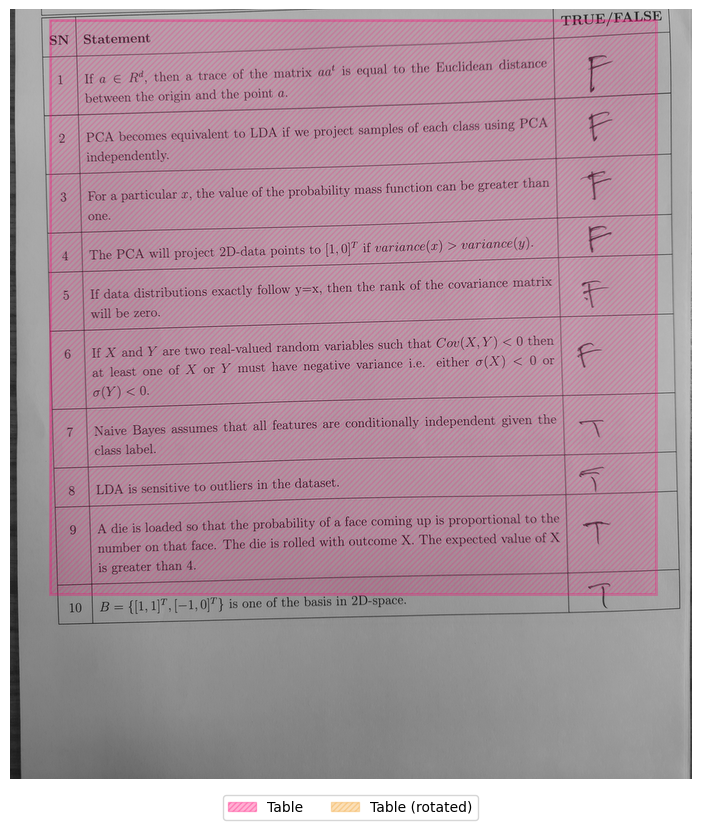

In [ ]:
# Visualize detected tables
fig = visualize_detected_tables(binary_pil, objects)
visualized_image = fig2img(fig)
visualized_image.show()

In [ ]:
# Crop table function
def objects_to_crops(img, tokens, objects, class_thresholds, padding):
    """
    Process the bounding boxes produced by the table detection model into
    cropped table images and cropped tokens.
    """

    table_crops = []
    for obj in objects:
        if obj['score'] < class_thresholds[obj['label']]:
            continue

        cropped_table = {}

        bbox = obj['bbox']
        bbox = [bbox[0]-padding, bbox[1]-padding, bbox[2]+padding, bbox[3]+padding]

        cropped_img = img.crop(bbox)

        table_tokens = [token for token in tokens if iob(token['bbox'], bbox) >= 0.5]
        for token in table_tokens:
            token['bbox'] = [token['bbox'][0]-bbox[0],
                             token['bbox'][1]-bbox[1],
                             token['bbox'][2]-bbox[0],
                             token['bbox'][3]-bbox[1]]

        # If table is predicted to be rotated, rotate cropped image and tokens/words:
        if obj['label'] == 'table rotated':
            cropped_img = cropped_img.rotate(270, expand=True)
            for token in table_tokens:
                bbox = token['bbox']
                bbox = [cropped_img.size[0]-bbox[3]-1,
                        bbox[0],
                        cropped_img.size[0]-bbox[1]-1,
                        bbox[2]]
                token['bbox'] = bbox

        cropped_table['image'] = cropped_img
        cropped_table['tokens'] = table_tokens

        table_crops.append(cropped_table)

    return table_crops

In [ ]:
#objects

[{'label': 'table',
  'score': 0.9987609386444092,
  'bbox': [551.283935546875,
   138.33592224121094,
   6667.14111328125,
   5938.92822265625]}]

In [ ]:
tokens = []
detection_class_thresholds = {
    "table": 0.5,
    "table rotated": 0.5,
    "no object": 10
}
crop_padding = 100

tables_crops = objects_to_crops(binary_pil, tokens, objects, detection_class_thresholds, padding=crop_padding)
cropped_table = tables_crops[0]['image'].convert("RGB")

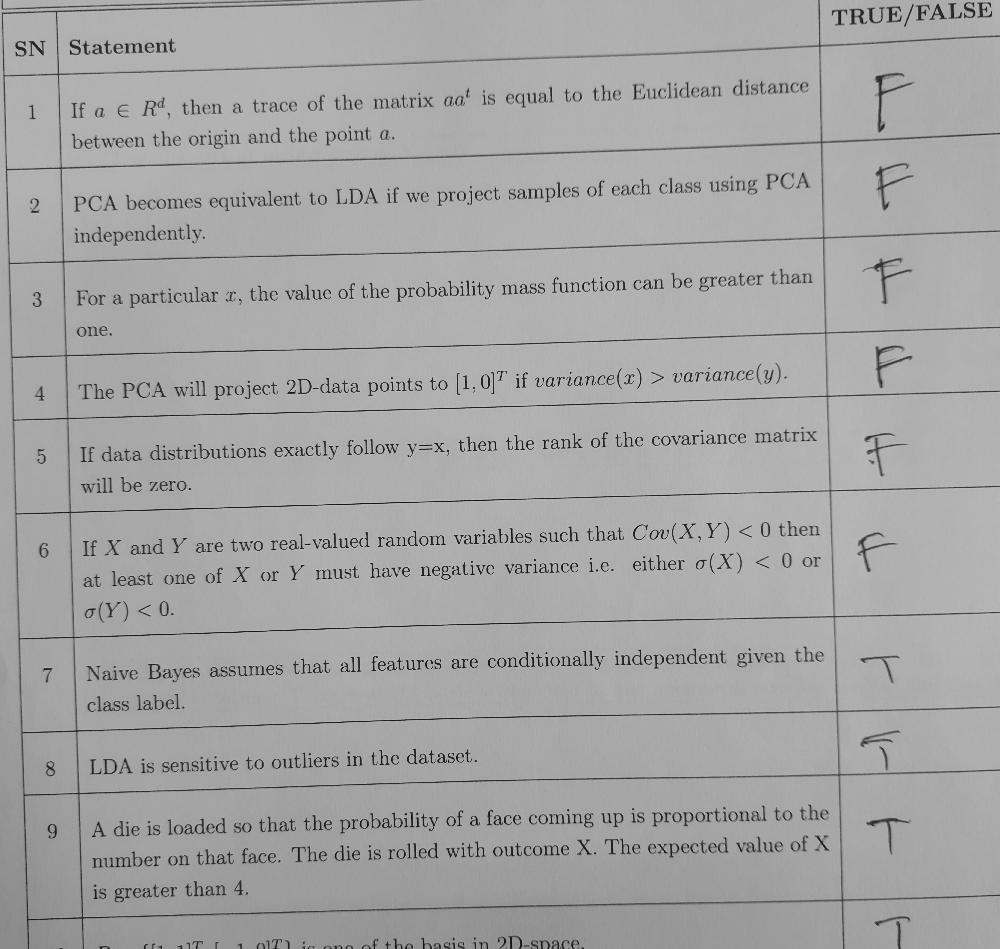

In [ ]:
cropped_table  #to show the cropped image

## TABLE Structure RECOG

In [ ]:
from transformers import TableTransformerForObjectDetection

# new v1.1 checkpoints require no timm anymore
structure_model = TableTransformerForObjectDetection.from_pretrained("microsoft/table-structure-recognition-v1.1-all")
structure_model.to(device)
print("")

config.json:   0%|          | 0.00/76.8k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/115M [00:00<?, ?B/s]

In [ ]:
structure_transform = transforms.Compose([
    MaxResize(1000),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

In [ ]:
pixel_values = structure_transform(cropped_table).unsqueeze(0)
pixel_values = pixel_values.to(device)
print(pixel_values.shape)

torch.Size([1, 3, 950, 1000])


In [ ]:
# forward pass
with torch.no_grad():
  outputs = structure_model(pixel_values)


In [ ]:
# update id2label to include "no object"
structure_id2label = structure_model.config.id2label
structure_id2label[len(structure_id2label)] = "no object"

cells = outputs_to_objects(outputs, cropped_table.size, structure_id2label)
print(cells)

[{'label': 'table column', 'score': 0.9998032450675964, 'bbox': [372.22509765625, 1.1998740434646606, 5227.32080078125, 5727.87744140625]}, {'label': 'table row', 'score': 0.9999727010726929, 'bbox': [77.39095306396484, 1609.1585693359375, 6288.60693359375, 2188.546875]}, {'label': 'table projected row header', 'score': 0.5962291359901428, 'bbox': [81.08257293701172, 3183.18603515625, 6286.654296875, 3921.654052734375]}, {'label': 'table row', 'score': 0.9996947050094604, 'bbox': [78.75190734863281, 394.0751953125, 6287.375, 1007.340087890625]}, {'label': 'table column', 'score': 0.9865314364433289, 'bbox': [5213.06884765625, 4.920039653778076, 6283.1201171875, 5728.51806640625]}, {'label': 'table column header', 'score': 0.9944487810134888, 'bbox': [79.02999114990234, 3.8107523918151855, 6288.02880859375, 419.30999755859375]}, {'label': 'table row', 'score': 0.999883770942688, 'bbox': [78.59095001220703, 1017.9782104492188, 6287.32421875, 1617.3128662109375]}, {'label': 'table row', '

In [ ]:
def plot_results(cells, class_to_visualize):
    if class_to_visualize not in structure_model.config.id2label.values():
      raise ValueError("Class should be one of the available classes")

    plt.figure(figsize=(16,10))
    plt.imshow(cropped_table)
    ax = plt.gca()

    for cell in cells:
        score = cell["score"]
        bbox = cell["bbox"]
        label = cell["label"]

        if label == class_to_visualize:
          xmin, ymin, xmax, ymax = tuple(bbox)

          ax.add_patch(plt.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin, fill=False, color="red", linewidth=3))
          text = f'{cell["label"]}: {score:0.2f}'
          ax.text(xmin, ymin, text, fontsize=15,
                  bbox=dict(facecolor='yellow', alpha=0.5))
          plt.axis('off')

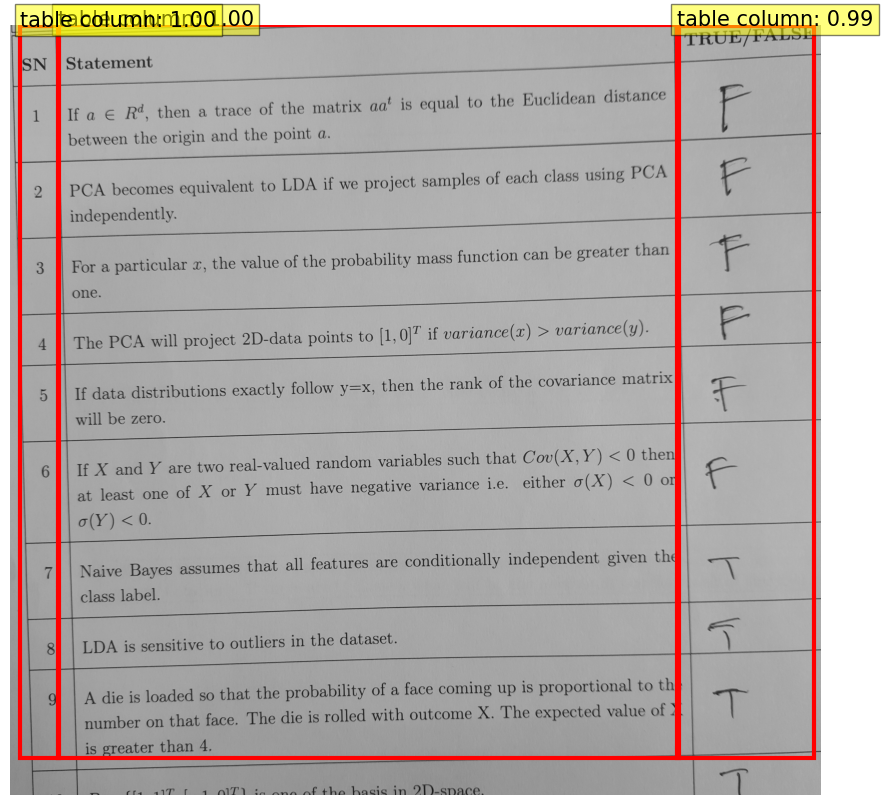

In [ ]:
plot_results(cells, class_to_visualize="table column")

In [ ]:
# Function to get cell coordinates
def get_cell_coordinates_by_row(table_data):
    # Extract rows and columns
    rows = [entry for entry in table_data if entry['label'] == 'table row']
    columns = [entry for entry in table_data if entry['label'] == 'table column']

    # Sort rows and columns by their Y and X coordinates, respectively
    rows.sort(key=lambda x: x['bbox'][1])
    columns.sort(key=lambda x: x['bbox'][0])

    # Function to find cell coordinates
    def find_cell_coordinates(row, column):
        cell_bbox = [column['bbox'][0], row['bbox'][1], column['bbox'][2], row['bbox'][3]]
        return cell_bbox

    # Generate cell coordinates and count cells in each row
    cell_coordinates = []

    for row in rows:
        row_cells = []
        for column in columns:
            cell_bbox = find_cell_coordinates(row, column)
            row_cells.append({'column': column['bbox'], 'cell': cell_bbox})

        # Sort cells in the row by X coordinate
        row_cells.sort(key=lambda x: x['column'][0])

        # Append row information to cell_coordinates
        cell_coordinates.append({'row': row['bbox'], 'cells': row_cells, 'cell_count': len(row_cells)})

    # Sort rows from top to bottom
    cell_coordinates.sort(key=lambda x: x['row'][1])

    return cell_coordinates

# Get the cell coordinates
cell_coordinates = get_cell_coordinates_by_row(cells)

# Extract the last column cells
last_column_cells = [row['cells'][-1]['cell'] for row in cell_coordinates]

In [ ]:
# Create a directory to save the images if it doesn't exist
output_dir = '/content/cropped_cells'
os.makedirs(output_dir, exist_ok=True)

In [ ]:
# Crop and display/save each cell in the last column
last_column_images = []
for idx, bbox in enumerate(last_column_cells):
    cell_image = cropped_table.crop(bbox)
    last_column_images.append(cell_image)
    #display.display(cell_image)

    # Save the resized cell image
    cell_image_path = os.path.join(output_dir, f'cell_{idx + 1}.png')
    cell_image.save(cell_image_path)
    print(f'Saved {cell_image_path}')

Saved /content/cropped_cells/cell_1.png
Saved /content/cropped_cells/cell_2.png
Saved /content/cropped_cells/cell_3.png
Saved /content/cropped_cells/cell_4.png
Saved /content/cropped_cells/cell_5.png
Saved /content/cropped_cells/cell_6.png
Saved /content/cropped_cells/cell_7.png
Saved /content/cropped_cells/cell_8.png
Saved /content/cropped_cells/cell_9.png
Saved /content/cropped_cells/cell_10.png


In [ ]:
# Directory containing the saved images
input_dir = output_dir
new_dir = '/content/binarized_cells'

In [ ]:
last_column_cells

[[5213.06884765625, 3.3313140869140625, 6283.1201171875, 416.71844482421875],
 [5213.06884765625, 394.0751953125, 6283.1201171875, 1007.340087890625],
 [5213.06884765625, 1017.9782104492188, 6283.1201171875, 1617.3128662109375],
 [5213.06884765625, 1609.1585693359375, 6283.1201171875, 2188.546875],
 [5213.06884765625, 2201.235107421875, 6283.1201171875, 2590.353759765625],
 [5213.06884765625, 2594.314453125, 6283.1201171875, 3183.5498046875],
 [5213.06884765625, 3204.68505859375, 6283.1201171875, 3969.441650390625],
 [5213.06884765625, 4016.45166015625, 6283.1201171875, 4612.0439453125],
 [5213.06884765625, 4632.5908203125, 6283.1201171875, 5026.6337890625],
 [5213.06884765625, 5043.494140625, 6283.1201171875, 5728.2412109375]]

In [ ]:
# Ensure the output directory exists
os.makedirs(new_dir, exist_ok=True)

# Get a list of all image files in the input directory
image_files = [f for f in os.listdir(input_dir) if f.endswith('.png')]

for image_file in image_files:
    # Open the image
    image_path = os.path.join(input_dir, image_file)
    image = Image.open(image_path)

    # Convert the image to grayscale
    grayscale_image = image.convert('L')

    # Convert the grayscale image to a numpy array
    image_array = np.array(grayscale_image)

    # Apply binarization using Otsu's thresholding
    _, binarized_image = cv.threshold(image_array, 0, 255, cv.THRESH_BINARY + cv.THRESH_OTSU)

    # Convert the binarized numpy array back to a PIL Image
    binarized_image_pil = Image.fromarray(binarized_image)

    # Save the binarized image
    binarized_image_path = os.path.join(new_dir, image_file)
    binarized_image_pil.save(binarized_image_path)

    print(f'Saved binarized image: {binarized_image_path}')

Saved binarized image: /content/binarized_cells/cell_5.png
Saved binarized image: /content/binarized_cells/cell_2.png
Saved binarized image: /content/binarized_cells/cell_6.png
Saved binarized image: /content/binarized_cells/cell_9.png
Saved binarized image: /content/binarized_cells/cell_3.png
Saved binarized image: /content/binarized_cells/cell_10.png
Saved binarized image: /content/binarized_cells/cell_4.png
Saved binarized image: /content/binarized_cells/cell_8.png
Saved binarized image: /content/binarized_cells/cell_7.png
Saved binarized image: /content/binarized_cells/cell_1.png


## Applying easy OCR

In [ ]:
!pip install -q easyocr

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 13.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 908.3/908.3 kB 23.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 307.2/307.2 kB 22.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21.3 MB 54.8 MB/s eta 0:00:00


In [ ]:
import easyocr

In [ ]:
reader = easyocr.Reader(['en'], gpu = True) # this needs to run only once to load the model into memory

Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.0% Complete

In [ ]:
new_dir

'/content/binarized_cells'

In [ ]:
ocr_results = []

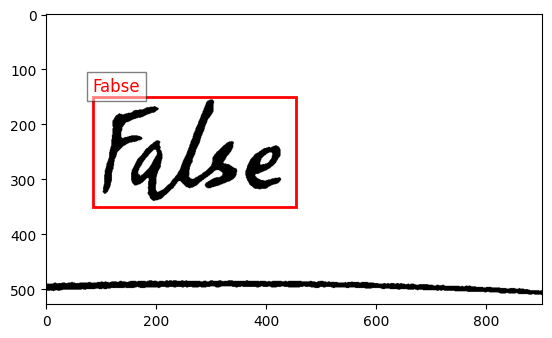

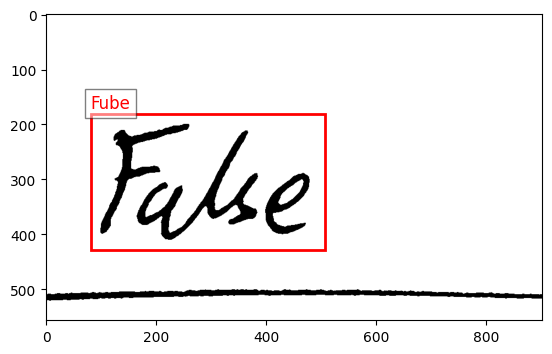

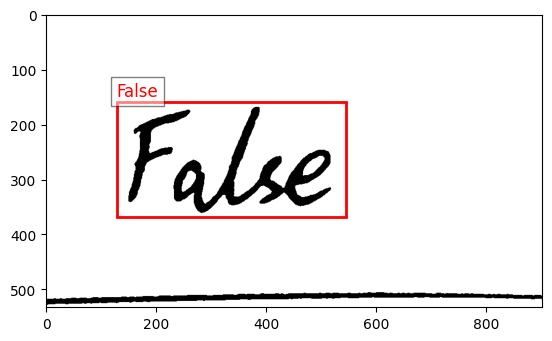

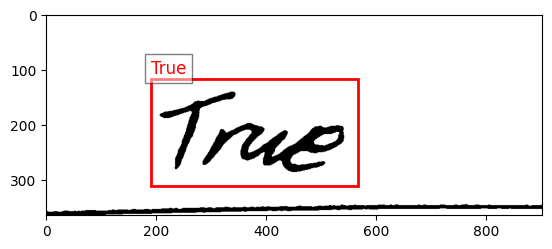

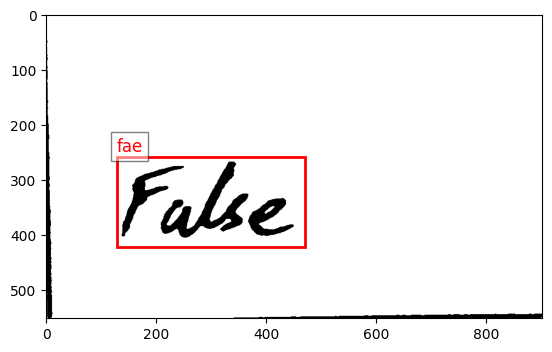

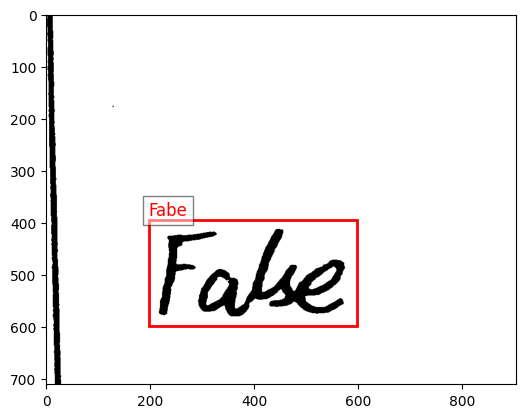

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,


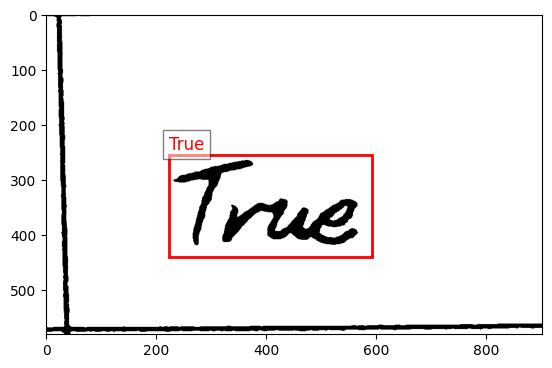

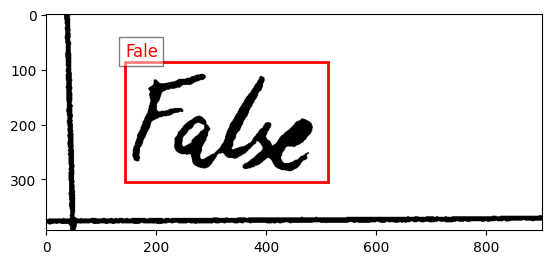

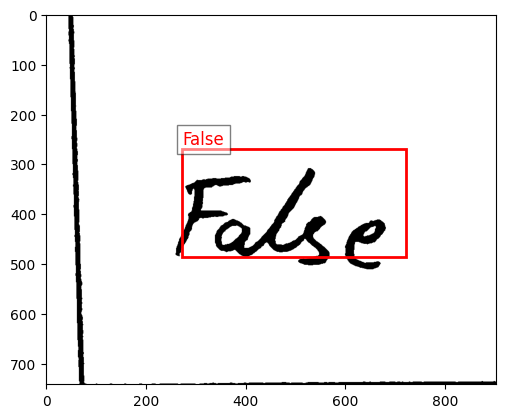

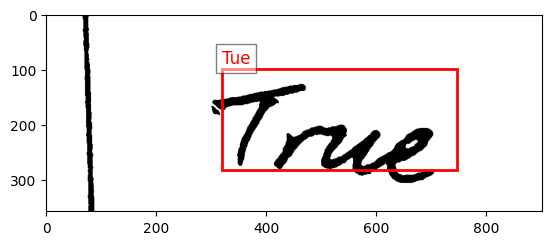

In [ ]:
# Loop through images cell_2.png to cell_11.png
for idx in range(2, 12):
    image_path = os.path.join(new_dir, f'cell_{idx}.png')
    if os.path.exists(image_path):
        # Load image
        image = Image.open(image_path)

        # Perform OCR
        result = reader.readtext(image_path)

        # Extract and store recognized text
        texts = [text for (_, text, _) in result]
        ocr_results.append(texts)

        # Plot image with bounding boxes
        fig, ax = plt.subplots(1)
        ax.imshow(image, cmap="gray")

        # Draw bounding boxes
        for (bbox, text, prob) in result:
            # Unpack the bounding box
            (top_left, top_right, bottom_right, bottom_left) = bbox
            top_left = tuple(map(int, top_left))
            top_right = tuple(map(int, top_right))
            bottom_right = tuple(map(int, bottom_right))
            bottom_left = tuple(map(int, bottom_left))

            # Calculate width and height
            width = top_right[0] - top_left[0]
            height = bottom_left[1] - top_left[1]

            # Create a Rectangle patch
            rect = patches.Rectangle(top_left, width, height, linewidth=2, edgecolor='r', facecolor='none')

            # Add the patch to the Axes
            ax.add_patch(rect)

            # Display the text
            plt.text(top_left[0], top_left[1] - 10, text, fontsize=12, color='red', bbox=dict(facecolor='white', alpha=0.5))

        # Show the plot
        plt.show()
    else:
        print(f'Image {image_path} does not exist')

In [ ]:
ocr_results

[['Fabse'],
 ['Fube'],
 ['False'],
 ['True'],
 ['fae'],
 ['Fabe'],
 ['True'],
 ['Fale'],
 ['False'],
 ['Tue']]